<a href="https://colab.research.google.com/github/somchx/ESText/blob/main/esc(lasted_version).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Sound Classification**

### import library

In [ ]:
# !pip install librosa
import librosa # Librosa เป็นแพ็คเกจ python ใช้สำหรับการวิเคราะห์เพลงและเสียง

In [ ]:
# IMPORT DEPENDENCIES

import requests, zipfile, io
from glob import glob
import matplotlib.pyplot as plt
from scipy import signal
from scipy.io import wavfile
import numpy as np
from tqdm import tqdm
import cv2
import pandas as pd
seed = 7
import pandas as pd
np.random.seed(seed)
import os

### create folder and load dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
fold = [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
fold

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]

### feaure extrauction

In [ ]:
# GENERATOR FUNCTION
def windows(data, window_size):
    start = 0
    while start < len(data):
        yield int(start), int(start + window_size)
        start += (window_size / 2)
        print(start)

# EXTRACT THE FEATURE OF SOUND USING MELSPECTROGRAM TECHNIQUE
def extract_features(bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []
    for folder in fold:
      for fn in os.listdir(f"/content/drive/MyDrive/dataset/{folder}/"):
        sound_name = f"/content/drive/MyDrive/dataset/{folder}/{fn}"
        sound_clip,s = librosa.load(sound_name) # 5 sec
        #sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # 10 sec
        label = folder
        for (start,end) in windows(sound_clip,window_size):
            if(len(sound_clip[start:end]) == window_size):
                signal = sound_clip[start:end]
                melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
                logspec = librosa.core.amplitude_to_db(melspec)
                logspec = logspec.T.flatten()[:, np.newaxis].T
                log_specgrams.append(logspec)
                labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features), np.array(labels,dtype = np.int)

In [ ]:
features, labels = extract_features()

Streaming output truncated to the last 5000 lines.
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
8

/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0


/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0


/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0


/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0


/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0
163840.0
174080.0
184320.0


/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0


/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0


/usr/local/lib/python3.8/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
10240.0
2

<ipython-input-5-fd1bc7c0ea35>:34: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  return np.array(features), np.array(labels,dtype = np.int)


In [ ]:
features.shape

(40240, 60, 41, 2)

In [ ]:
labels.shape

(40240,)

### label

In [ ]:
my_dict = {0: 'เสียงหมาเห่า',
 1: 'เสียงคลื่นน้ำ',
 2: 'เสียงไฟปะทุ',
 3: 'เสียงพายุฝน',
 4: 'เสียงคนร้อง',
 5: 'เสียงเดิน',
 6: 'เสียงเคาะ',
 7: 'เสียงประตู',
 8: 'เสียงกระจกแตก',
 9: 'เสียงรถหวอ',
 10: 'เสียงแตรรถ',
 11: 'เสียงเครื่องยนต์',
 12: 'เสียงเครื่องบิน',
 13: 'เสียงยิงปืน',
 14: 'เสียงรถจักรยานยนต์',
 15: 'เสียงปรบมือ',
 16: 'เสียงรถชน',
}
my_dict

{0: 'เสียงหมาเห่า',
 1: 'เสียงคลื่นน้ำ',
 2: 'เสียงไฟปะทุ',
 3: 'เสียงพายุฝน',
 4: 'เสียงคนร้อง',
 5: 'เสียงเดิน',
 6: 'เสียงเคาะ',
 7: 'เสียงประตู',
 8: 'เสียงกระจกแตก',
 9: 'เสียงรถหวอ',
 10: 'เสียงแตรรถ',
 11: 'เสียงเครื่องยนต์',
 12: 'เสียงเครื่องบิน',
 13: 'เสียงยิงปืน',
 14: 'เสียงรถจักรยานยนต์',
 15: 'เสียงปรบมือ',
 16: 'เสียงรถชน'}

In [ ]:
seed = 4
rng = np.random.RandomState(seed)

In [ ]:
import tensorflow as tf
import keras
from keras.models import Model
from keras.layers import Input, Dense, Dropout, Activation
from keras.layers import Conv2D, GlobalAveragePooling2D
from keras.layers import BatchNormalization, Add
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.models import load_model

### one-hot encoder

In [ ]:
onehot_labels = tf.keras.utils.to_categorical(labels,num_classes=17)

In [ ]:
len(onehot_labels)

40240

### Create train-test Dataset

In [ ]:
# Create train / test Dataset

rnd_indices = np.random.rand(len(labels)) < 0.70

X_train = features[rnd_indices] # 70
y_train = onehot_labels[rnd_indices] # 70
X_test  = features[~rnd_indices] # 30
y_test  = onehot_labels[~rnd_indices] # 30

In [ ]:
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((28160, 60, 41, 2), (28160, 17), (12080, 60, 41, 2), (12080, 17))

In [ ]:
X_train[0].shape

(60, 41, 2)

In [ ]:
y_train[0].shape

(17,)

In [ ]:
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import Dropout
from keras.layers import Flatten,InputLayer
from keras.layers.convolutional import Conv2D
from keras.layers.convolutional import MaxPooling2D
from keras.utils import np_utils
from keras.constraints import maxnorm
from keras.callbacks import ModelCheckpoint
from keras.initializers import normal, VarianceScaling
from keras import initializers
from keras.layers import BatchNormalization
### initializer of weights
# initializer = normal(mean=0, stddev=0.01, seed=13)
# initializer = VarianceScaling(scale=1.0, mode='fan_in', distribution='normal',

In [ ]:
Adam = tf.keras.optimizers.Adam

### CNN model

In [ ]:
def basemodel():
    model = Sequential()

    #Hidden Layer
    # 1st Layer
    model.add(Conv2D(32, (2, 2), input_shape=(60,41,2), activation='relu', padding='same', kernel_initializer=initializers.RandomUniform(minval=-0.05, maxval=0.05, seed=None), bias_initializer='ones'))
    model.add(Conv2D(32, (2, 2), activation='relu', padding='same'))
    model.add(MaxPooling2D(pool_size=(2, 2),padding='same'))

    # 2nd Layer
    model.add(Conv2D(64, (2, 2), activation='relu', padding='same'))
    model.add(Conv2D(64, (2, 2), activation='relu', padding='same'))
    model.add(MaxPooling2D(pool_size=(2, 2),padding='same'))

    # 3rd Layer
    model.add(Conv2D(128, (2, 2), activation='relu', padding='same'))
    model.add(Conv2D(128, (2, 2), activation='relu', padding='same'))
    model.add(MaxPooling2D(pool_size=(2, 2),padding='same'))

    # Classification (Output Layer)
    model.add(Flatten())
    model.add(Dense(1024, activation='relu', kernel_constraint=maxnorm(3)))
    model.add(Dense(512, activation='relu', kernel_constraint=maxnorm(3)))

    #OUTPUT
    model.add(Dense(17, activation='softmax'))

    # Compile model
    epochs, lrate = 25, 0.01
    decay = lrate/epochs
    optimizer = Adam()
    #adam = tf.keras.optimizers.legacy(learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=None, amsgrad=False)
    model.compile(loss='categorical_crossentropy', optimizer = optimizer, metrics=['accuracy'])
    return model

In [ ]:
#  if not os.path.exists('model'):
#     os.makedirs('model')

# filepath="model/weights_0.best.hdf5"
#checkpoint = ModelCheckpoint(filepath, monitor='val_acc', verbose=1, save_best_only=True, mode='max')
#callbacks_list = [checkpoint]

In [ ]:
model = basemodel()
print(model.summary())

NameError: ignored

In [ ]:
from keras.preprocessing.image import ImageDataGenerator

### image augmentation

In [ ]:
datagen = ImageDataGenerator(
              width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
              height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
              horizontal_flip=True,  # randomly flip images
              vertical_flip=False)  # randomly flip images

### train model

In [ ]:
batch_size = 64
epochs = 200

In [ ]:
# fit the model
history = model.fit_generator(datagen.flow(X_train, y_train, batch_size=batch_size),
                              steps_per_epoch=int(np.ceil(X_train.shape[0] / float(batch_size))),
                              epochs=epochs,
                              validation_data=(X_test, y_test),
                              verbose=1)

/usr/local/lib/python3.8/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (28160, 60, 41, 2) (2 channels).
  warnings.warn(
<ipython-input-34-e2f052792d10>:2: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(datagen.flow(X_train, y_train, batch_size=batch_size),


Epoch 1/200


### save model

In [ ]:
#filepath='model_5s.h5'
#model.save(filepath)

### load model

In [ ]:
#predict_model = load_model(filepath)
#predict_model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 60, 41, 32)        288       
                                                                 
 batch_normalization_27 (Bat  (None, 60, 41, 32)       128       
 chNormalization)                                                
                                                                 
 dropout_18 (Dropout)        (None, 60, 41, 32)        0         
                                                                 
 conv2d_19 (Conv2D)          (None, 60, 41, 32)        4128      
                                                                 
 batch_normalization_28 (Bat  (None, 60, 41, 32)       128       
 chNormalization)                                                
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 30, 21, 32)      

### save model (.h5 & json)

In [ ]:
import pickle as p

In [ ]:
filepath_history_model = 'history_model'

with open(filepath_history_model, 'wb') as file:
    p.dump(history.history, file)

In [ ]:
filepath_model = 'model_17class.json'
filepath_weights = 'weights_model_17class.h5'

model_json = model.to_json()
with open(filepath_model, "w") as json_file:
    json_file.write(model_json)
    model.save_weights(filepath_weights)

### Load model (.h5 & json)

In [ ]:
model_from_json = tf.keras.models.model_from_json

In [ ]:
with open(filepath_model, 'r') as f:
    loaded_model_json = f.read()
    predict_model = model_from_json(loaded_model_json)
    predict_model.load_weights(filepath_weights)

In [ ]:
predict_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

predict_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 60, 41, 32)        288       
                                                                 
 batch_normalization (BatchN  (None, 60, 41, 32)       128       
 ormalization)                                                   
                                                                 
 dropout (Dropout)           (None, 60, 41, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 60, 41, 32)        4128      
                                                                 
 batch_normalization_1 (Batc  (None, 60, 41, 32)       128       
 hNormalization)                                                 
                                                                 
 max_pooling2d (MaxPooling2D  (None, 30, 21, 32)       0

### accuracy

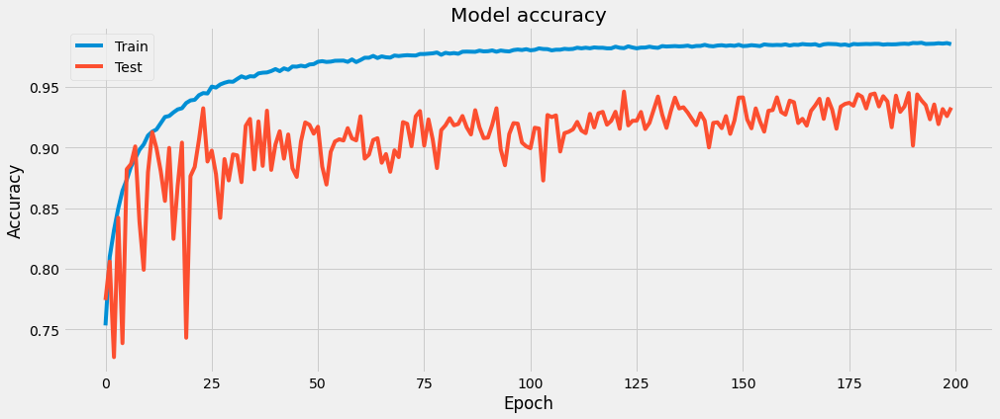

In [ ]:
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
# Plot training & validation accuracy values
plt.figure(figsize=(15,6))
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

### loss

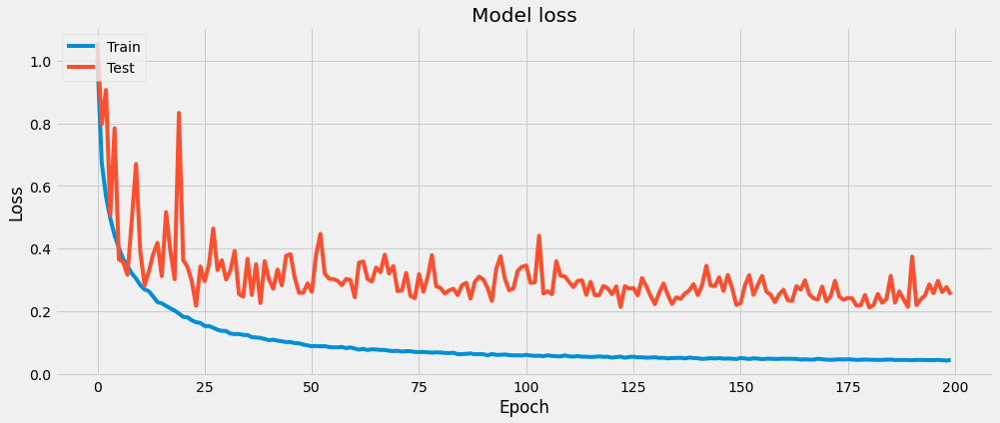

In [ ]:
# Plot training & validation loss values
plt.figure(figsize=(15,6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

### evaluate model

In [ ]:
# evaluate model
model.evaluate(X_test, y_test)

378/378 [==============================] - 1s 3ms/step - loss: 0.2522 - accuracy: 0.9329


[0.2522153854370117, 0.932947039604187]

### Classification Report

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
# target_name = np.array(df['category'])
# target_name

In [ ]:
target_name1 = my_dict.values()
target_name1

dict_values(['เสียงหมาเห่า', 'เสียงคลื่นน้ำ', 'เสียงไฟปะทุ', 'เสียงพายุฝน', 'เสียงคนร้อง', 'เสียงเดิน', 'เสียงเคาะ', 'เสียงประตู', 'เสียงกระจกแตก', 'เสียงรถหวอ', 'เสียงแตรรถ', 'เสียงเครื่องยนต์', 'เสียงเครื่องบิน', 'เสียงยิงปืน', 'เสียงรถจักรยานยนต์', 'เสียงปรบมือ', 'เสียงรถชน'])

In [ ]:
y_true = np.argmax(y_test,axis=1)

y_pred = np.argmax(model.predict(X_test),axis=1)

print(classification_report(y_true,y_pred,target_names=target_name1))

378/378 [==============================] - 1s 3ms/step
                    precision    recall  f1-score   support

      เสียงหมาเห่า       0.85      0.85      0.85       211
     เสียงคลื่นน้ำ       0.90      0.84      0.87       249
       เสียงไฟปะทุ       1.00      0.97      0.98      8668
       เสียงพายุฝน       0.53      0.93      0.68       274
       เสียงคนร้อง       0.88      0.75      0.81       180
         เสียงเดิน       0.90      0.94      0.92       248
         เสียงเคาะ       0.76      0.67      0.71       168
        เสียงประตู       0.75      0.57      0.65       183
     เสียงกระจกแตก       0.49      0.82      0.61       146
        เสียงรถหวอ       0.96      0.95      0.96       244
        เสียงแตรรถ       0.53      0.80      0.64       204
  เสียงเครื่องยนต์       0.95      0.94      0.94       222
   เสียงเครื่องบิน       0.83      0.86      0.85       258
       เสียงยิงปืน       0.86      0.91      0.88        65
เสียงรถจักรยานยนต์       0.93      0.87     

In [ ]:
label_num = my_dict.keys()

### Confusion Matrix

<ipython-input-39-6f1ef517c6f6>:7: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax= plt.subplot()


Text(0.5, 1.0, 'Confusion Matrix')

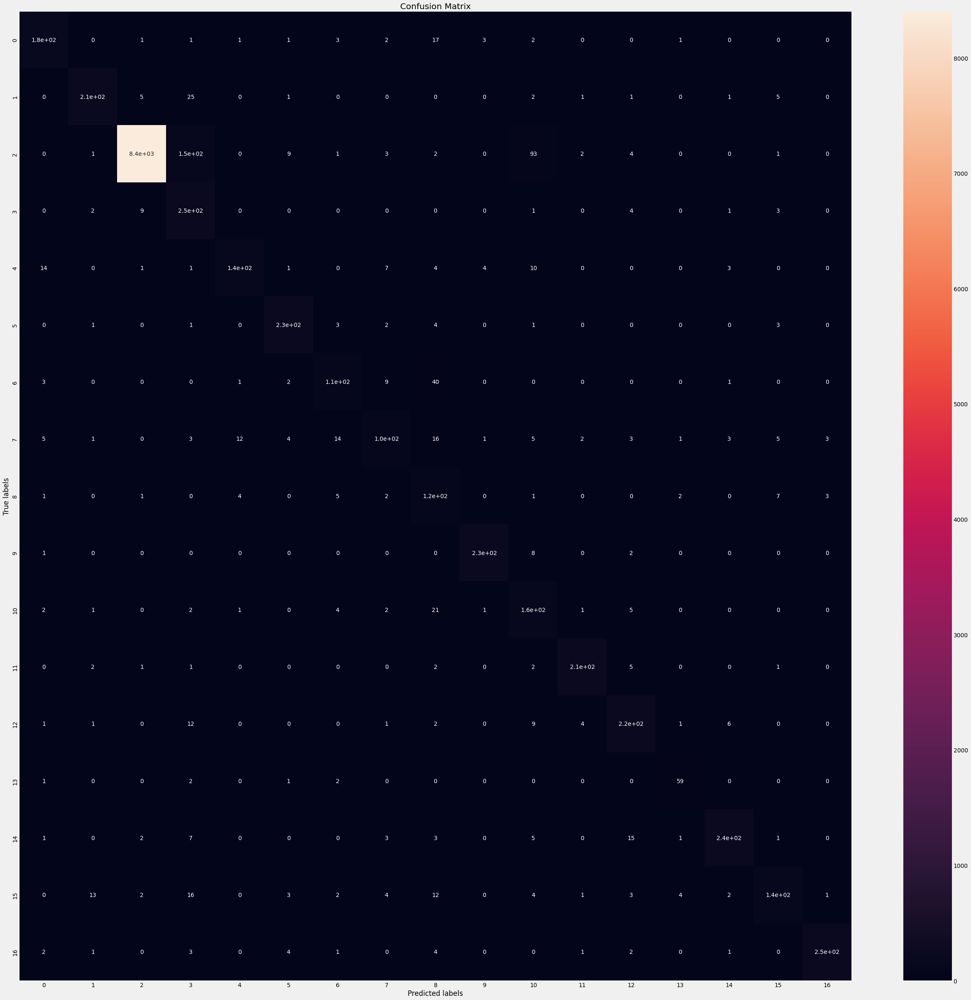

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
cn_matrix = confusion_matrix(y_true,y_pred)
plt.figure(figsize = (40,40))
sns.heatmap(cn_matrix, annot=True)
# labels, title and ticks
ax= plt.subplot()
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')

In [ ]:
cn_matrix

array([[ 179,    0,    1,    1,    1,    1,    3,    2,   17,    3,    2,
           0,    0,    1,    0,    0,    0],
       [   0,  208,    5,   25,    0,    1,    0,    0,    0,    0,    2,
           1,    1,    0,    1,    5,    0],
       [   0,    1, 8403,  149,    0,    9,    1,    3,    2,    0,   93,
           2,    4,    0,    0,    1,    0],
       [   0,    2,    9,  254,    0,    0,    0,    0,    0,    0,    1,
           0,    4,    0,    1,    3,    0],
       [  14,    0,    1,    1,  135,    1,    0,    7,    4,    4,   10,
           0,    0,    0,    3,    0,    0],
       [   0,    1,    0,    1,    0,  233,    3,    2,    4,    0,    1,
           0,    0,    0,    0,    3,    0],
       [   3,    0,    0,    0,    1,    2,  112,    9,   40,    0,    0,
           0,    0,    0,    1,    0,    0],
       [   5,    1,    0,    3,   12,    4,   14,  105,   16,    1,    5,
           2,    3,    1,    3,    5,    3],
       [   1,    0,    1,    0,    4,    0,    5

In [ ]:
for item in cn_matrix:
     print(item)

[179   0   1   1   1   1   3   2  17   3   2   0   0   1   0   0   0]
[  0 208   5  25   0   1   0   0   0   0   2   1   1   0   1   5   0]
[   0    1 8403  149    0    9    1    3    2    0   93    2    4    0
    0    1    0]
[  0   2   9 254   0   0   0   0   0   0   1   0   4   0   1   3   0]
[ 14   0   1   1 135   1   0   7   4   4  10   0   0   0   3   0   0]
[  0   1   0   1   0 233   3   2   4   0   1   0   0   0   0   3   0]
[  3   0   0   0   1   2 112   9  40   0   0   0   0   0   1   0   0]
[  5   1   0   3  12   4  14 105  16   1   5   2   3   1   3   5   3]
[  1   0   1   0   4   0   5   2 120   0   1   0   0   2   0   7   3]
[  1   0   0   0   0   0   0   0   0 233   8   0   2   0   0   0   0]
[  2   1   0   2   1   0   4   2  21   1 164   1   5   0   0   0   0]
[  0   2   1   1   0   0   0   0   2   0   2 208   5   0   0   1   0]
[  1   1   0  12   0   0   0   1   2   0   9   4 221   1   6   0   0]
[ 1  0  0  2  0  1  2  0  0  0  0  0  0 59  0  0  0]
[  1   0   2   7   

# **Predict**

In [ ]:
import IPython.display as ipd
import librosa
import librosa.display

## Seawave

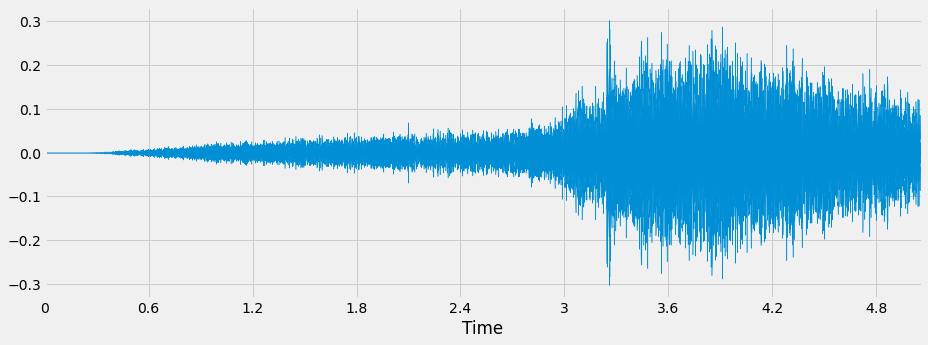

In [ ]:
### seawave
file_name = "/content/seawave.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path = "/content/seawave.wav"
result_predict = predict_one(file_path)

predictions = model.predict(result_predict)
print(predictions)

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
1/1 [==============================] - 0s 129ms/step
[[7.85361465e-08 1.52463053e-09 3.50886298e-09 1.02435804e-09
  3.31228622e-09 5.68458915e-07 5.66689451e-09 1.40798861e-09
  2.03204098e-09 3.46100570e-09 3.29112055e-07 4.82478426e-05
  1.98448835e-09 2.81547408e-09 2.07626680e-08 2.43037590e-08
  7.78562343e-03 1.08964429e-08 3.07128545e-09 6.61101788e-02
  8.21445312e-09 2.81015189e-09 3.72018111e-11 3.06312464e-09
  3.19822768e-09 1.67032832e-10 3.93975919e-09 2.24079022e-09
  3.56133345e-09 2.53532018e-09 3.93758683e-06 2.75453238e-09
  1.07992137e-09 8.98919325e-07 1.13424170e-09 3.64523167e-09
  2.51499999e-09 1.58120039e-09 7.25506633e-09 8.07737255e-09
  9.26049054e-01 3.44127105e-09 7.96636186e-07 6.97457807e-08
  6.20816176e-11 4.87678964e-09 7.32845873e-09 2.68881628e-08
  6.15121465e-09 4.81285367e-09]
 [3.70502312e-05 1.58770973e-07 3.92551447e-05 2.20787956e-06
  1.76527209e-07 4

In [ ]:
result_predict.shape

(9, 60, 41, 2)

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[40 11 11 11 11 11 11 11 11]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[40, 11]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

11 : เสียงคลื่นน้ำ
40 : เสียงเครื่องบิน


In [ ]:
from sklearn.ensemble import VotingClassifier



---



## Wind

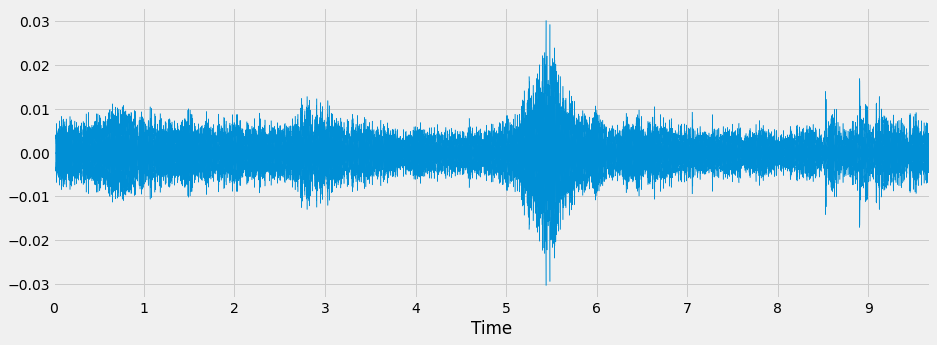

In [ ]:
### wind
file_name = "/content/wind.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/wind.wav"
result_predict = predict_one(file_path)

predictions = model.predict(result_predict)
print(predictions)

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0
163840.0
174080.0
184320.0
194560.0
204800.0
215040.0
225280.0
235520.0
245760.0
256000.0
266240.0
276480.0
286720.0
296960.0
307200.0
317440.0
327680.0
337920.0
348160.0
358400.0
368640.0
378880.0
389120.0
399360.0
409600.0
419840.0
430080.0
2/2 [==============================] - 0s 103ms/step
[[6.30651787e-03 5.78998367e-07 1.67482239e-09 ... 4.43311787e-04
  7.38031758e-07 4.40364062e-07]
 [1.77030005e-02 5.95524696e-08 1.19538086e-07 ... 1.27042178e-04
  4.55261038e-08 2.77084720e-08]
 [3.84780504e-02 2.79446279e-08 2.39024894e-06 ... 2.63191936e-07
  9.39530480e-08 2.89908844e-08]
 ...
 [1.30574316e-01 1.00148725e-08 1.69742793e-06 ... 4.04244787e-07
  1.54953117e-08 5.99064487e-09]
 [3.35760713e-02 2.31544517e-09 1.27011763e-05 ... 3.74469295e-07
  2.07788475e-09 8.52345916e-10]
 [2.58669015e-02 1.31136879e-09 9.69153407e-05 ... 5.25073301e-06
  9.62631086

In [ ]:
result_predict.shape

(40, 60, 41, 2)

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[30 43 30  5  0  5  5 30  5  5  5  5  5  5 43  5  0  5  5  5 43 30 30  5
  5  0  5  5 30  5  5  5  5  5  0 43  5  5  5  5]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[30, 43, 5, 0]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

0 : เสียงหมาเห่า
5 : เสียงแมวร้อง
30 : เสียงเคาะ
43 : เสียงแตร




---



## Scream

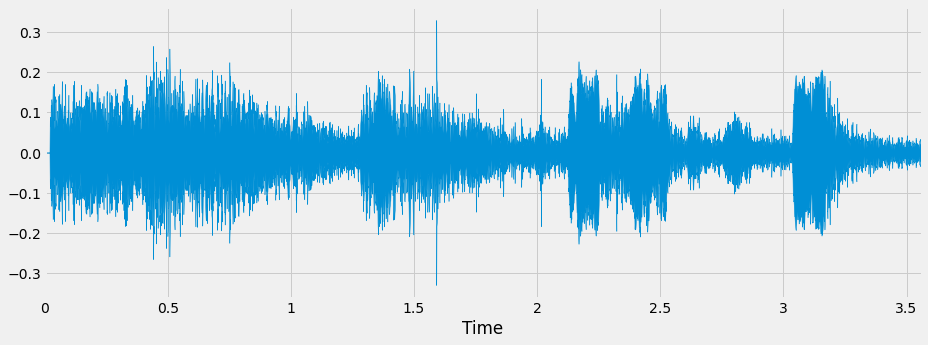

In [ ]:
### scream
file_name = "/content/scream.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/scream.wav"
result_predict = predict_one(file_path)

predictions = model.predict(result_predict)
print(predictions)

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0
163840.0
1/1 [==============================] - 0s 131ms/step
[[1.06470427e-03 1.28879222e-07 1.99969800e-04 8.93224239e-01
  1.19446071e-07 1.46652702e-02 1.18776669e-07 8.20998736e-08
  6.69673383e-08 1.05754253e-07 2.67362765e-07 3.54561575e-06
  7.78007234e-07 6.81100758e-08 9.18794854e-08 1.42951151e-07
  2.14302636e-05 1.32587118e-07 9.00154546e-08 2.62830508e-06
  1.85949192e-03 1.84367748e-03 8.36020045e-05 6.53194121e-08
  7.62851560e-05 1.31872355e-07 7.06432886e-08 1.14258441e-07
  7.91482861e-08 3.88591550e-02 1.68566658e-05 8.97945966e-08
  8.70508217e-08 3.55897530e-04 7.60444721e-08 2.14896957e-07
  1.14199722e-07 1.00948178e-07 7.50290425e-08 4.82453252e-05
  1.12652907e-03 1.10845136e-07 2.87752841e-02 1.69455837e-02
  6.80538790e-07 2.88171315e-04 5.58663906e-08 5.34967287e-04
  1.13361274e-07 1.13133289e-07]
 [1.75249818e-06 2.21449916e-08 8.7

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[ 3  3  3  3  5  5 20  3 42  3  3  3  5 42]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[3, 5, 20, 42]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

3 : เสียงวัวร้อง
5 : เสียงแมวร้อง
20 : เสียงคนร้อง
42 : เสียงหวอ




---



## Footstep

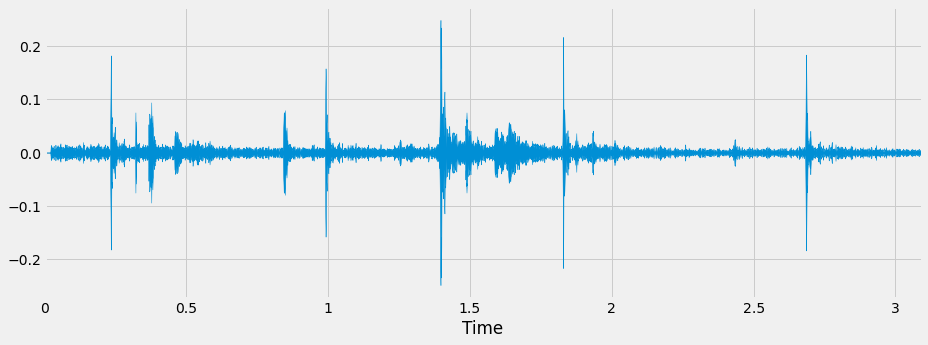

In [ ]:
### footsteps
file_name = "/content/footsteps.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/footsteps.wav"
result_predict = predict_one(file_path)

result_predict

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0


array([[[[-4.71264839e+01, -1.72558931e+00],
         [-5.48882370e+01, -1.72558931e+00],
         [-4.92217293e+01, -1.72558931e+00],
         ...,
         [-7.36299896e+01, -3.88207840e-15],
         [-7.36299896e+01, -3.88207840e-15],
         [-7.36299896e+01, -3.88207840e-15]],

        [[-7.36299896e+01, -3.88207840e-15],
         [-7.36299896e+01, -3.88207840e-15],
         [-7.36299896e+01, -3.88207840e-15],
         ...,
         [-7.08662033e+01, -3.24869741e+00],
         [-5.83789253e+01, -3.24869741e+00],
         [-5.81007919e+01, -3.24869741e+00]],

        [[-5.03535461e+01, -1.33512402e+00],
         [-5.38875504e+01, -1.33512402e+00],
         [-5.71797752e+01, -1.33512402e+00],
         ...,
         [-3.22168427e+01,  6.52076349e+00],
         [-2.96252728e+01,  6.52076349e+00],
         [-2.75217896e+01,  6.52076349e+00]],

        ...,

        [[-7.36299896e+01,  4.37168010e+00],
         [-7.36299896e+01,  4.37168010e+00],
         [-7.36299896e+01,  4.37168010

In [ ]:
predictions = model.predict(result_predict)
print(predictions)

1/1 [==============================] - 0s 126ms/step
[[8.73454269e-07 4.06867372e-07 8.24776886e-04 6.24841033e-03
  5.96727148e-07 1.20894147e-04 6.69139411e-07 1.09907944e-06
  5.29216265e-07 3.14238179e-07 6.43675157e-05 3.89087567e-04
  5.02268374e-02 5.35703805e-07 3.80922899e-07 1.84377527e-03
  2.00986551e-06 2.79768999e-03 3.59016752e-07 1.18899829e-04
  4.75876504e-06 2.44213811e-06 5.83358705e-02 7.32126637e-07
  1.00517909e-05 8.71716022e-01 6.57887085e-07 7.44819317e-07
  2.98790837e-07 7.19198666e-04 3.62540304e-05 7.31335319e-07
  6.13462703e-07 2.70384135e-05 4.29815884e-07 5.69227664e-03
  6.60326521e-07 1.41454996e-06 4.30215323e-07 3.54793301e-04
  2.02802789e-06 3.77317463e-07 2.67145897e-05 4.98886766e-05
  1.43914906e-06 3.64913314e-04 5.80896142e-07 4.89692320e-06
  6.05691469e-07 5.65981054e-07]
 [1.04129949e-09 8.63266933e-08 5.47335901e-07 4.12154776e-07
  1.28658286e-07 5.01474915e-07 1.34876203e-07 1.70985388e-07
  5.91534430e-08 1.31478174e-07 8.57967370e-06

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[25 25 25 25 19 19 25 25 25 25 12 19]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[25, 19, 12]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

12 : เสียงไฟปะทุ
19 : เสียงพายุฝนฟ้าคะนอง
25 : เสียงเดิน




---



## Vaccum

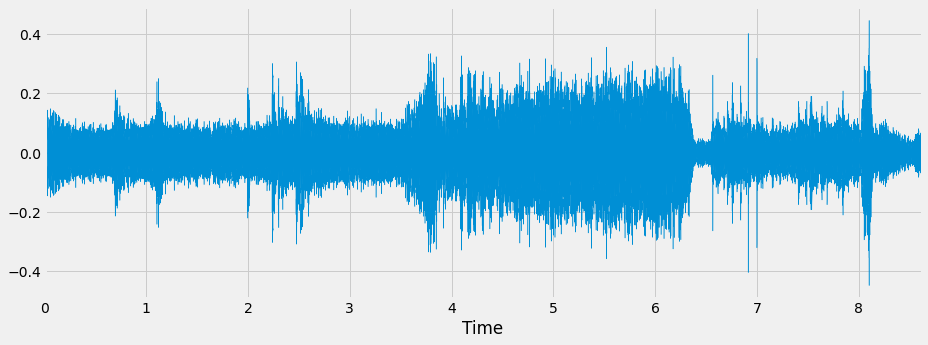

In [ ]:
### vacuum
file_name = "/content/vaccum.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/vaccum.wav"
result_predict = predict_one(file_path)

predictions = model.predict(result_predict)
print(predictions)

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0
163840.0
174080.0
184320.0
194560.0
204800.0
215040.0
225280.0
235520.0
245760.0
256000.0
266240.0
276480.0
286720.0
296960.0
307200.0
317440.0
327680.0
337920.0
348160.0
358400.0
368640.0
378880.0
389120.0
2/2 [==============================] - 0s 95ms/step
[[6.8810135e-05 3.4234461e-05 3.4931273e-04 ... 5.6604128e-03
  2.4569215e-05 1.1255728e-04]
 [4.1610612e-05 5.0698462e-05 2.2214812e-05 ... 9.1753085e-05
  3.6438162e-06 1.0024726e-03]
 [2.6002314e-09 7.9363599e-07 5.0333764e-08 ... 1.8083661e-06
  2.3632381e-07 2.7636181e-06]
 ...
 [1.2498086e-07 3.3442498e-09 8.8860617e-07 ... 2.8895015e-09
  1.2533619e-09 8.7459298e-08]
 [1.3547700e-09 1.3046375e-09 4.1176737e-08 ... 3.9135803e-10
  9.8244281e-11 1.6979346e-08]
 [2.0552535e-07 3.6574217e-08 1.3433339e-04 ... 6.3254633e-06
  1.5832951e-07 4.6942998e-05]]


In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[36 18 18 18 18 36 36 41 10 10 10 47 47 18 18 18 18 18 18  8 18 10 18 18
 36 41 10 10 10 47 47  7 18 18 18 18]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[36, 18, 41, 10, 47, 8, 7]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

7 : insects
8 : sheep
10 : rain
18 : toilet_flush
36 : vacuum_cleaner
41 : chainsaw
47 : airplane




---



## rainNthunderstorm

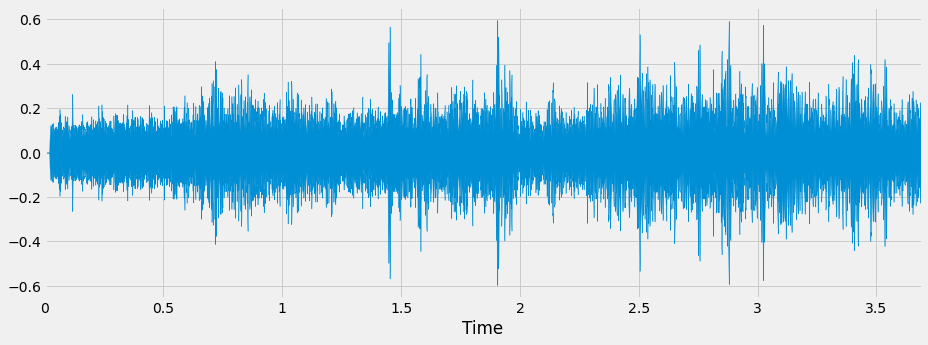

In [ ]:
### rainNthunderstorm
file_name = "/content/rainNthunderstorm.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path = "/content/rainNthunderstorm.wav"
result_predict = predict_one(file_path)

predictions = model.predict(result_predict)
print(predictions)

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0
163840.0
1/1 [==============================] - 0s 25ms/step
[[3.19033411e-10 2.07057246e-10 3.78181619e-09 8.64944297e-11
  2.18616791e-10 3.92287591e-10 1.45484985e-10 2.17583479e-10
  1.62067276e-10 3.25821925e-10 9.99997377e-01 5.40367573e-08
  2.19719798e-08 8.01775729e-11 1.67222070e-10 1.80495996e-09
  1.72564100e-07 1.54798112e-08 3.20990873e-10 4.74918451e-08
  8.80931494e-10 8.07271194e-10 1.79446111e-11 9.42472975e-11
  4.08561052e-09 7.05112342e-08 2.30958197e-10 1.44807541e-10
  2.24062532e-10 1.87558580e-11 1.90457250e-08 1.99648673e-10
  2.27832045e-10 1.22860067e-09 1.17118065e-10 3.24524798e-08
  1.74610604e-10 1.94179756e-10 1.85195415e-10 1.08268274e-08
  2.08214874e-06 1.70556985e-10 5.11812204e-10 5.77898227e-08
  1.10257268e-07 2.55153711e-08 1.46978832e-10 3.75231490e-09
  1.84780122e-10 1.97591998e-10]
 [4.74968731e-10 4.89563101e-09 6.90

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[10 10 10 10 10 10 10 10 10 10 10 10 10 10]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[10]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

10 : เสียงฝนตก




---



## thunderstorm

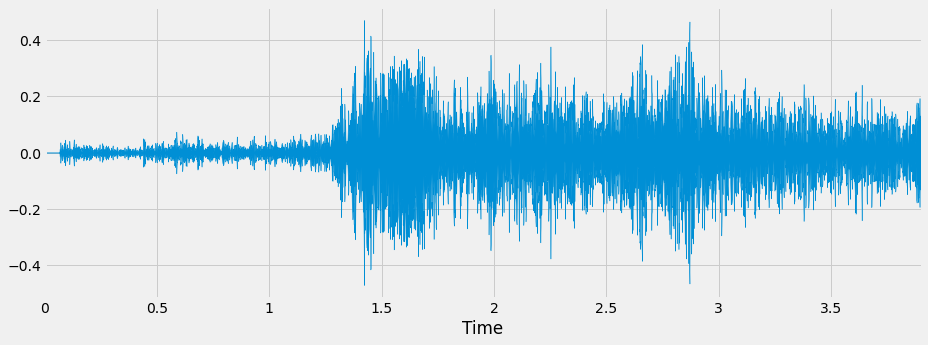

In [ ]:
### thunderstorm
file_name = "/content/thunderstorm.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/thunderstorm.wav"
result_predict = predict_one(file_path)

predictions = model.predict(result_predict)
print(predictions)

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0
163840.0
174080.0
1/1 [==============================] - 0s 132ms/step
[[2.47929712e-08 3.26953076e-10 6.80087851e-07 9.26112589e-11
  1.82106635e-10 5.72825502e-06 1.52566140e-10 5.65614278e-10
  2.75419271e-10 1.05976602e-10 4.67764210e-08 7.01402172e-08
  1.08270752e-08 2.82428608e-10 1.16737148e-10 2.51864787e-08
  7.26196100e-04 1.25746311e-08 3.66737640e-10 9.99208033e-01
  5.68428854e-12 4.64606531e-09 1.85138282e-09 2.75871964e-10
  6.44305387e-10 3.70714881e-09 1.64407973e-10 1.43557916e-10
  1.35809836e-10 4.66524845e-08 1.20875029e-07 1.44354723e-10
  2.05869530e-10 1.07248276e-07 2.16683088e-10 2.43811138e-10
  3.86652377e-10 5.25540833e-10 3.13046589e-10 5.39521761e-09
  2.07283774e-05 1.98245795e-10 3.79129960e-05 5.80935158e-08
  2.17570077e-11 1.07020028e-07 2.26946836e-10 8.79738522e-08
  2.65118316e-10 1.43794671e-10]
 [5.10462094e-04 3.2915345

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[19 19 19 45 16 19 19 19 19 19 11 45 43 43 19]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[19, 45, 16, 11, 43]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

11 : เสียงคลื่นน้ำ
16 : เสียงลม
19 : เสียงพายุฝนฟ้าคะนอง
43 : เสียงแตร
45 : เสียงรถไฟ




---



## thunderstorm2

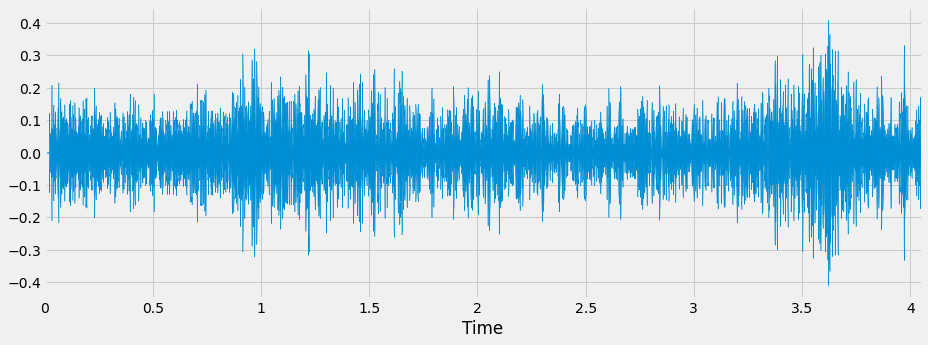

In [ ]:
### thunderstorm2
file_name = "/content/thunderstorm2.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =   "/content/thunderstorm2.wav"
result_predict = predict_one(file_path)

predictions = model.predict(result_predict)
print(predictions)

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0
163840.0
174080.0
184320.0
1/1 [==============================] - 0s 129ms/step
[[2.28315855e-07 1.61847122e-08 7.65857422e-09 1.95937417e-08
  5.01238429e-09 1.07351115e-08 9.35099024e-07 3.81553355e-06
  1.66768522e-03 6.72008582e-07 9.24476296e-07 5.56662144e-07
  1.58583502e-09 5.05246589e-06 5.69352174e-08 1.72056886e-07
  4.74582165e-01 1.25109665e-08 2.09214079e-07 2.06333891e-01
  1.43856298e-07 8.02329536e-10 1.88454682e-10 4.56450948e-08
  1.42255790e-10 7.52436691e-09 4.42437961e-11 3.55024787e-09
  1.16741838e-07 2.08766437e-07 1.89816524e-06 2.36524089e-09
  1.17587454e-07 2.44499824e-06 5.08750304e-07 2.67716041e-05
  2.47824337e-05 1.86693342e-07 3.03818268e-07 1.69068475e-08
  1.42365205e-03 4.77337530e-08 1.71527572e-05 1.14464965e-05
  2.42164488e-09 1.18138746e-03 6.49799347e-07 3.14711601e-01
  8.49222559e-08 1.58877321e-11]
 [4.38721615e-10 

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[16 16 16 16 16 16 16 19 16 16 16 16 16 16 16 16]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[16, 19]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

16 : wind
19 : thunderstorm




---



## Siren

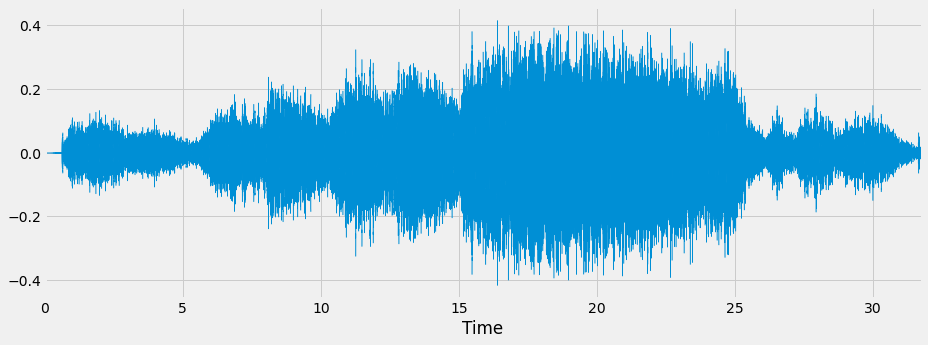

In [ ]:
### siren
file_name = "/content/siren.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/siren.wav"
result_predict = predict_one(file_path)

predictions = model.predict(result_predict)
print(predictions)

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0
163840.0
174080.0
184320.0
194560.0
204800.0
215040.0
225280.0
235520.0
245760.0
256000.0
266240.0
276480.0
286720.0
296960.0
307200.0
317440.0
327680.0
337920.0
348160.0
358400.0
368640.0
378880.0
389120.0
399360.0
409600.0
419840.0
430080.0
440320.0
450560.0
460800.0
471040.0
481280.0
491520.0
501760.0
512000.0
522240.0
532480.0
542720.0
552960.0
563200.0
573440.0
583680.0
593920.0
604160.0
614400.0
624640.0
634880.0
645120.0
655360.0
665600.0
675840.0
686080.0
696320.0
706560.0
716800.0
727040.0
737280.0
747520.0
757760.0
768000.0
778240.0
788480.0
798720.0
808960.0
819200.0
829440.0
839680.0
849920.0
860160.0
870400.0
880640.0
890880.0
901120.0
911360.0
921600.0
931840.0
942080.0
952320.0
962560.0
972800.0
983040.0
993280.0
1003520.0
1013760.0
1024000.0
1034240.0
1044480.0
1054720.0
1064960.0
1075200.0
1085440.0
1095680.0
1105920.0
1116160.0
1126400.0
113664

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[37 13 13 13 46 13 13 46 46 13 46 13 13 13 46 46 13 42 47 47 47 40 42 42
 42 46 42 42 46 47 40 46 42 42 42 42 42 46 42 46 46 46 46 46 46 46 46 46
 46 46 46 46 46 46 46 46 46 13 13 13 13 46 46 46 46 46 46  1 15 13 13 13
 13 46 13 46 46 16 16 46 13 13 46 46 13 13 28 47 47 46 16 42 42 46 42 42
 42 46 40 40 46 42 42 42 42 46 46 46 42 46 46 46 46 46 46 46 46 46 46 46
  4 46 46 46 46 46 13 13 13 46 13 13 46 46 46]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[37, 13, 46, 42, 47, 40, 1, 15, 16, 28, 4]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

1 : rooster
4 : frog
13 : crickets
15 : water_drops
16 : wind
28 : snoring
37 : clock_alarm
40 : helicopter
42 : siren
46 : church_bells
47 : airplane




---



## Car

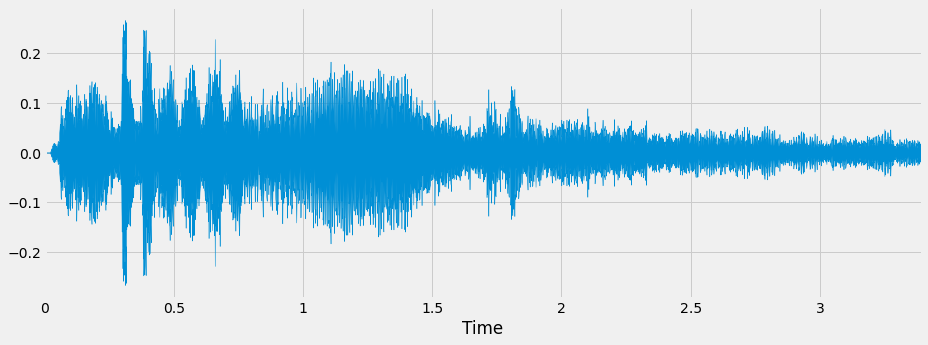

In [ ]:
### car
file_name = "/content/car.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/car.wav"
result_predict = predict_one(file_path)

result_predict

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0


array([[[[-5.49305038e+01, -2.21361542e-01],
         [-5.05032730e+01, -2.21361542e-01],
         [-5.49305038e+01, -2.21361542e-01],
         ...,
         [-5.49305038e+01, -5.21908443e-15],
         [-5.49305038e+01, -5.21908443e-15],
         [-5.49305038e+01, -5.21908443e-15]],

        [[-5.49305038e+01, -5.21908443e-15],
         [-5.49305038e+01, -5.21908443e-15],
         [-5.49305038e+01, -5.21908443e-15],
         ...,
         [-5.49305038e+01, -2.82365913e+00],
         [-5.49305038e+01, -2.82365913e+00],
         [-5.40866470e+01, -2.82365913e+00]],

        [[-5.49305038e+01,  9.75486946e-01],
         [-5.41636810e+01,  9.75486946e-01],
         [-5.49305038e+01,  9.75486946e-01],
         ...,
         [-3.92696838e+01,  3.52237876e+00],
         [-2.82115765e+01,  3.52237876e+00],
         [-2.99644279e+01,  3.52237876e+00]],

        ...,

        [[-4.59779434e+01,  4.90174772e+00],
         [-5.29961586e+01,  4.90174772e+00],
         [-5.49305038e+01,  4.90174772

In [ ]:
predictions = model.predict(result_predict)
print(predictions)

[[1.15481844e-05 1.30466872e-03 2.90530559e-04 2.37428409e-04
  1.00358156e-04 1.93181145e-03 1.83893993e-04 1.14041716e-02
  3.41895549e-03 3.08002956e-04 1.48029136e-03 1.00702920e-03
  6.35014439e-05 3.58457078e-06 8.08780624e-06 1.42269616e-03
  4.56425823e-06 2.02265568e-02 3.45684171e-01 5.53965856e-06
  1.59241969e-03 9.85316699e-04 2.60649947e-03 9.46330896e-04
  5.56265877e-04 2.17523589e-03 1.23999850e-03 4.17162024e-04
  6.91928290e-05 3.11368203e-04 2.12343675e-05 9.44724379e-05
  1.11887377e-04 5.25092939e-04 1.04599378e-04 1.13246766e-04
  1.61169935e-03 4.62445041e-06 7.19505333e-05 4.48014826e-01
  4.16071387e-03 1.43777609e-01 2.75585971e-05 1.63967808e-04
  3.39142745e-04 7.50647087e-05 4.93585772e-04 4.26520492e-05
  5.23530616e-05 1.96539520e-04]
 [4.88053986e-10 5.10221732e-08 2.37359236e-05 7.39321104e-06
  3.62586725e-05 1.18988669e-06 1.17041132e-07 1.09731027e-05
  2.23082188e-05 4.10962626e-02 2.01976673e-05 1.06006974e-06
  5.40145766e-06 1.15250259e-06 9.495

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[39 41 41 41 41 43 46  7 41 41 41 41 43]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[39, 41, 43, 46, 7]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

7 : insects
39 : glass_breaking
41 : chainsaw
43 : car_horn
46 : church_bells


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
target_name = np.array(df['category'])

In [ ]:
y_true = np.argmax(y_test,axis=1)

y_pred = np.argmax(model.predict(X_test),axis=1)

print(classification_report(y_true,y_pred,target_names=target_name))

                  precision    recall  f1-score   support

             dog       0.65      0.70      0.67       104
         rooster       0.52      0.39      0.44       108
             pig       0.94      0.48      0.64       100
             cow       0.47      0.62      0.54       118
            frog       0.85      0.85      0.85       110
             cat       0.34      0.55      0.42       107
             hen       0.67      0.52      0.58        99
         insects       0.60      0.75      0.67       106
           sheep       0.70      0.70      0.70       108
            crow       0.80      0.76      0.78       106
            rain       0.88      0.93      0.91       105
       sea_waves       0.73      0.87      0.79       100
  crackling_fire       0.90      0.67      0.77       105
        crickets       0.81      0.93      0.86        99
  chirping_birds       0.88      0.51      0.65       113
     water_drops       0.49      0.33      0.39       109
            w



---



## horn

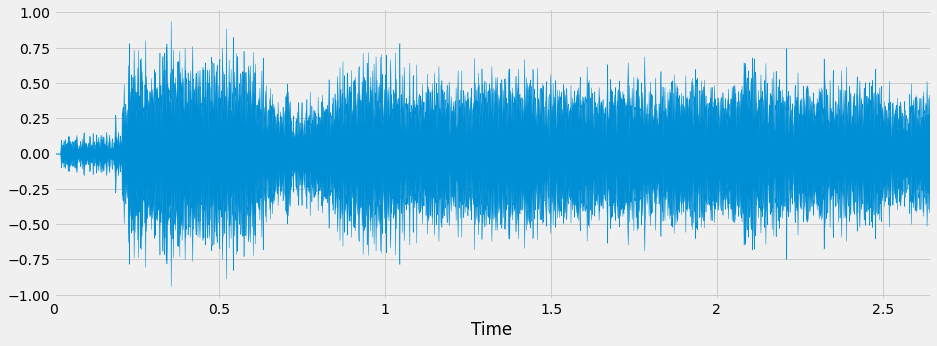

In [ ]:
### horn
file_name = "/content/horn.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/horn.wav"
result_predict = predict_one(file_path)

result_predict

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0


array([[[[-1.12203674e+01, -3.20464225e+00],
         [ 9.63989556e-01, -3.20464225e+00],
         [-2.82343483e+00, -3.20464225e+00],
         ...,
         [-2.58238831e+01, -1.05594460e-15],
         [-2.58238831e+01, -1.05594460e-15],
         [-2.58238831e+01, -1.05594460e-15]],

        [[-2.58238831e+01, -1.05594460e-15],
         [-2.58238831e+01, -1.05594460e-15],
         [-2.58238831e+01, -1.05594460e-15],
         ...,
         [-2.58238831e+01, -1.42352622e+00],
         [-2.58238831e+01, -1.42352622e+00],
         [-2.58238831e+01, -1.42352622e+00]],

        [[-2.58238831e+01, -1.05594460e-15],
         [-2.58238831e+01, -1.05594460e-15],
         [-2.58238831e+01, -1.05594460e-15],
         ...,
         [ 1.51552429e+01,  6.30295865e+00],
         [ 2.04824238e+01,  6.30295865e+00],
         [ 1.35012035e+01,  6.30295865e+00]],

        ...,

        [[-2.58238831e+01,  7.22519604e+00],
         [-2.58238831e+01,  7.22519604e+00],
         [-2.58238831e+01,  7.22519604

In [ ]:
predictions = model.predict(result_predict)
print(predictions)

[[4.72937652e-04 2.34159634e-05 1.40454469e-03 1.27703766e-03
  1.68700431e-08 1.18302596e-05 8.22420261e-05 8.88718106e-03
  2.94473671e-06 2.31986905e-05 7.11491331e-04 9.08508152e-02
  1.50484505e-06 7.21609808e-07 5.15610964e-07 4.52695849e-06
  2.14993721e-03 1.72318232e-06 7.88914214e-04 7.45818973e-01
  6.29888120e-07 1.80837433e-05 5.35909805e-07 1.28729289e-05
  6.09762856e-06 8.93351797e-04 5.91511025e-06 2.02098207e-07
  6.32785959e-05 7.00045319e-04 3.38654267e-04 5.21217180e-06
  1.59103752e-06 8.82600398e-06 7.30848187e-05 5.62470268e-05
  1.14775663e-04 5.82680468e-06 1.13042472e-04 6.99030861e-05
  8.24056938e-03 3.73308873e-03 1.25454957e-04 2.22938973e-02
  1.49985613e-06 1.05775492e-02 8.35028756e-03 9.12567675e-02
  1.06972839e-05 4.07540123e-04]
 [1.81513242e-04 1.14290524e-05 2.37849363e-05 3.40341963e-02
  5.63589175e-09 3.59973055e-05 2.65692506e-06 9.97461728e-04
  2.93952917e-06 5.94164048e-05 1.67719656e-04 1.67732053e-02
  9.16420078e-08 2.13109524e-06 9.932

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[19 46 40 40 40 19 11 40 40 40]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[19, 46, 40, 11]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

11 : sea_waves
19 : thunderstorm
40 : helicopter
46 : church_bells


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
target_name = np.array(df['category'])

In [ ]:
y_true = np.argmax(y_test,axis=1)

y_pred = np.argmax(model.predict(X_test),axis=1)

print(classification_report(y_true,y_pred,target_names=target_name))

                  precision    recall  f1-score   support

             dog       0.65      0.70      0.67       104
         rooster       0.52      0.39      0.44       108
             pig       0.94      0.48      0.64       100
             cow       0.47      0.62      0.54       118
            frog       0.85      0.85      0.85       110
             cat       0.34      0.55      0.42       107
             hen       0.67      0.52      0.58        99
         insects       0.60      0.75      0.67       106
           sheep       0.70      0.70      0.70       108
            crow       0.80      0.76      0.78       106
            rain       0.88      0.93      0.91       105
       sea_waves       0.73      0.87      0.79       100
  crackling_fire       0.90      0.67      0.77       105
        crickets       0.81      0.93      0.86        99
  chirping_birds       0.88      0.51      0.65       113
     water_drops       0.49      0.33      0.39       109
            w



---



## clap

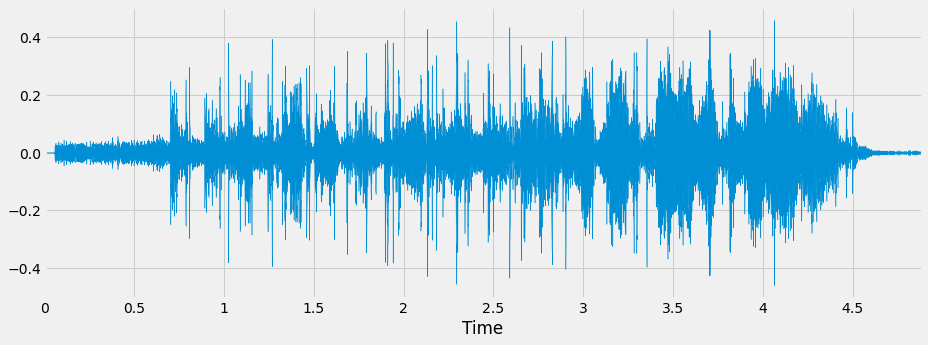

In [ ]:
### clap
file_name = "/content/clap.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/clap.wav"
result_predict = predict_one(file_path)

result_predict

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0
163840.0
174080.0
184320.0
194560.0
204800.0
215040.0
225280.0


array([[[[-7.06542282e+01, -4.01005439e-15],
         [-7.06542282e+01, -4.01005439e-15],
         [-7.06542282e+01, -4.01005439e-15],
         ...,
         [-7.06542282e+01, -4.01005439e-15],
         [-7.06542282e+01, -4.01005439e-15],
         [-7.06542282e+01, -4.01005439e-15]],

        [[-7.06542282e+01, -4.01005439e-15],
         [-7.06542282e+01, -4.01005439e-15],
         [-7.06542282e+01, -4.01005439e-15],
         ...,
         [-7.06542282e+01, -3.66161474e-01],
         [-7.06542282e+01, -3.66161474e-01],
         [-7.06542282e+01, -3.66161474e-01]],

        [[-7.06542282e+01, -4.01005439e-15],
         [-7.06542282e+01, -4.01005439e-15],
         [-7.06542282e+01, -4.01005439e-15],
         ...,
         [-3.44688148e+01,  5.81336899e+00],
         [-3.66811905e+01,  5.81336899e+00],
         [-2.70261784e+01,  5.81336899e+00]],

        ...,

        [[-3.42912407e+01,  3.21807178e+00],
         [-3.32269821e+01,  3.21807178e+00],
         [-5.04280510e+01,  3.21807178

In [ ]:
predictions = model.predict(result_predict)
print(predictions)

[[1.79951647e-04 1.08145512e-04 1.30239688e-03 7.40808100e-02
  7.77905807e-05 7.20338430e-05 9.24651104e-04 7.60497630e-01
  1.95613168e-02 4.36696596e-02 4.45175465e-05 4.08243760e-03
  1.57569793e-05 3.86691449e-04 2.32713137e-04 2.74538752e-06
  1.11119938e-03 4.98467273e-07 5.47748023e-05 1.26682757e-03
  3.41572413e-05 1.28925050e-04 2.42089765e-04 4.55663394e-05
  1.24201033e-04 5.45229741e-05 1.53496640e-05 1.72660511e-04
  7.98783822e-06 6.81675039e-04 1.76128833e-05 1.33397733e-03
  1.35385868e-04 5.70603600e-03 4.55866793e-05 7.30665168e-04
  1.67401558e-05 3.39930702e-05 4.30710061e-05 7.37260780e-06
  2.47755051e-02 1.88757125e-02 1.56741371e-04 3.41270305e-02
  4.91098152e-04 3.10057258e-05 1.38885365e-03 1.88133528e-03
  2.56139610e-04 7.66519632e-04]
 [2.14548072e-06 6.96976531e-06 4.78935181e-05 7.07705214e-04
  1.44559861e-04 3.60956365e-05 8.00266207e-05 7.58282654e-03
  4.98598092e-04 1.27239182e-05 7.04245613e-05 2.67625600e-03
  9.40676080e-04 3.05427646e-04 2.407

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[ 7 22 18 18 22 22  7 18 18  4  7  7 27 27 27 18 22  7 18  8]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[7, 22, 18, 4, 27, 8]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

4 : frog
7 : insects
8 : sheep
18 : toilet_flush
22 : clapping
27 : brushing_teeth


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
target_name = np.array(df['category'])

In [ ]:
y_true = np.argmax(y_test,axis=1)

y_pred = np.argmax(model.predict(X_test),axis=1)

print(classification_report(y_true,y_pred,target_names=target_name))

                  precision    recall  f1-score   support

             dog       0.65      0.70      0.67       104
         rooster       0.52      0.39      0.44       108
             pig       0.94      0.48      0.64       100
             cow       0.47      0.62      0.54       118
            frog       0.85      0.85      0.85       110
             cat       0.34      0.55      0.42       107
             hen       0.67      0.52      0.58        99
         insects       0.60      0.75      0.67       106
           sheep       0.70      0.70      0.70       108
            crow       0.80      0.76      0.78       106
            rain       0.88      0.93      0.91       105
       sea_waves       0.73      0.87      0.79       100
  crackling_fire       0.90      0.67      0.77       105
        crickets       0.81      0.93      0.86        99
  chirping_birds       0.88      0.51      0.65       113
     water_drops       0.49      0.33      0.39       109
            w



---



## plane

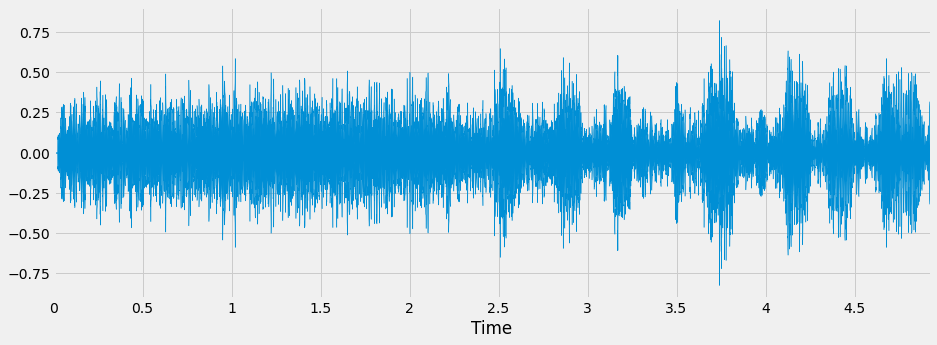

In [ ]:
### plane
file_name = "/content/plane.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/plane.wav"
result_predict = predict_one(file_path)

result_predict

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0
163840.0
174080.0
184320.0
194560.0
204800.0
215040.0
225280.0


array([[[[ 2.06555891e+00, -2.33700726e+00],
         [-1.28967273e+00, -2.33700726e+00],
         [-9.52268219e+00, -2.33700726e+00],
         ...,
         [-3.03005257e+01,  6.31860915e-17],
         [-3.03005257e+01,  6.31860915e-17],
         [-3.03005257e+01,  6.31860915e-17]],

        [[-3.03005257e+01,  6.31860915e-17],
         [-3.03005257e+01,  6.31860915e-17],
         [-3.03005257e+01,  6.31860915e-17],
         ...,
         [-1.48194752e+01, -2.65075332e+00],
         [-1.11725330e+01, -2.65075332e+00],
         [-1.51604671e+01, -2.65075332e+00]],

        [[-1.31927862e+01, -1.58854459e+00],
         [-1.03970776e+01, -1.58854459e+00],
         [-2.56427536e+01, -1.58854459e+00],
         ...,
         [ 4.32076340e+01,  8.50349127e+00],
         [ 3.79029617e+01,  8.50349127e+00],
         [ 9.34514809e+00,  8.50349127e+00]],

        ...,

        [[-3.03005257e+01,  4.86289255e+00],
         [-3.03005257e+01,  4.86289255e+00],
         [-3.03005257e+01,  4.86289255

In [ ]:
predictions = model.predict(result_predict)
print(predictions)

[[4.90484297e-07 1.00211707e-07 4.55956943e-08 5.99200430e-05
  2.19388969e-08 6.15258742e-08 5.34209448e-07 1.26738257e-06
  1.78694754e-05 2.70148539e-05 4.48060920e-03 6.17058063e-03
  7.17771229e-08 8.87184724e-05 7.17995396e-09 4.24464957e-07
  9.94669180e-03 1.03692770e-07 1.29232349e-05 1.49560728e-05
  6.34982555e-09 6.27602788e-07 3.94039444e-06 1.26436703e-06
  5.55450515e-06 7.63449862e-07 1.33965031e-07 9.76113483e-07
  4.12390733e-07 1.61780247e-06 1.20776834e-03 8.61702283e-05
  4.31814300e-07 2.34177764e-06 2.88097795e-07 2.36249116e-06
  4.41734228e-05 6.22972379e-07 5.24939381e-08 6.67023471e-07
  7.73108527e-02 1.07080647e-04 1.34797783e-05 2.58646207e-03
  8.97380710e-01 1.19812094e-05 1.22155063e-06 4.04944498e-04
  3.39916824e-08 6.16142131e-07]
 [2.14597571e-06 1.36458226e-07 4.33292726e-08 6.72839742e-05
  8.36489278e-09 8.07806941e-08 2.44946193e-07 4.31443993e-07
  6.92296862e-06 2.58527939e-06 2.20704882e-04 1.06202820e-02
  2.16520686e-08 1.20684905e-04 1.316

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[44 40 40 40 40  9 45  6  0 49 44 40 40 40 40  9  0  2  0  0]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[44, 40, 9, 45, 6, 0, 49, 2]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

0 : dog
2 : pig
6 : hen
9 : crow
40 : helicopter
44 : engine
45 : train
49 : hand_saw


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
target_name = np.array(df['category'])

In [ ]:
y_true = np.argmax(y_test,axis=1)

y_pred = np.argmax(model.predict(X_test),axis=1)

print(classification_report(y_true,y_pred,target_names=target_name))

                  precision    recall  f1-score   support

             dog       0.65      0.70      0.67       104
         rooster       0.52      0.39      0.44       108
             pig       0.94      0.48      0.64       100
             cow       0.47      0.62      0.54       118
            frog       0.85      0.85      0.85       110
             cat       0.34      0.55      0.42       107
             hen       0.67      0.52      0.58        99
         insects       0.60      0.75      0.67       106
           sheep       0.70      0.70      0.70       108
            crow       0.80      0.76      0.78       106
            rain       0.88      0.93      0.91       105
       sea_waves       0.73      0.87      0.79       100
  crackling_fire       0.90      0.67      0.77       105
        crickets       0.81      0.93      0.86        99
  chirping_birds       0.88      0.51      0.65       113
     water_drops       0.49      0.33      0.39       109
            w



---



## knock

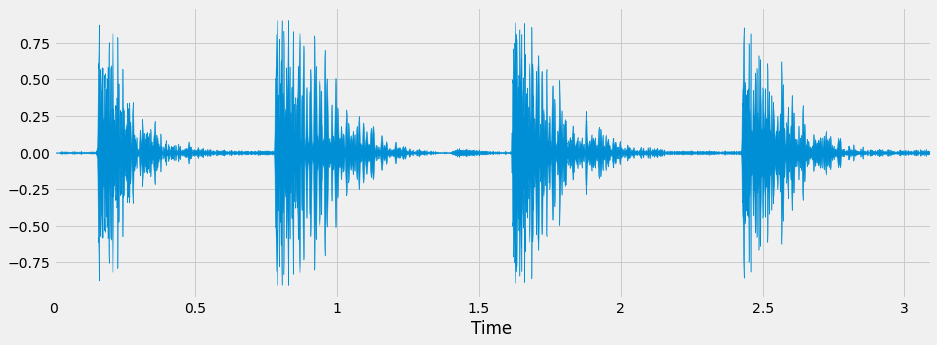

In [ ]:
### knock
file_name = "/content/knock.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/knock.wav"
result_predict = predict_one(file_path)

result_predict

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0


array([[[[-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16],
         ...,
         [-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16]],

        [[-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16],
         ...,
         [-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16]],

        [[-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16],
         ...,
         [-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16],
         [-1.85154953e+01, -9.88580914e-16]],

        ...,

        [[-1.85154953e+01,  3.69852328e+00],
         [-1.85154953e+01,  3.69852328e+00],
         [-1.85154953e+01,  3.69852328

In [ ]:
predictions = model.predict(result_predict)
print(predictions)

[[3.01076594e-04 3.02428060e-09 3.93411028e-06 3.91640542e-09
  1.23040067e-08 1.54458957e-09 1.83359430e-06 3.01229647e-06
  1.33782263e-09 1.15980363e-07 7.29230237e-07 5.05626163e-09
  2.40734721e-06 1.23277800e-06 1.32123191e-07 8.35992978e-06
  2.66200968e-05 4.22052757e-08 3.65133435e-09 7.17355942e-05
  2.17411227e-08 2.59544578e-07 6.91009927e-06 2.09019632e-07
  2.01587100e-04 3.60896392e-03 4.02451815e-06 1.48663204e-07
  6.20301307e-07 1.62722688e-04 9.94480014e-01 4.23647435e-07
  1.53798538e-07 1.26299972e-06 1.56820363e-06 8.15638998e-07
  5.78034154e-08 3.51321781e-08 7.35323738e-06 1.46137737e-07
  2.76404637e-04 1.08884950e-10 7.22911109e-09 2.88460154e-08
  2.20063086e-07 2.86946192e-06 2.78206365e-08 8.96211461e-08
  8.21748166e-04 3.16047419e-08]
 [1.25164047e-06 2.40545523e-06 1.29946739e-06 1.90293960e-07
  8.28007529e-09 2.98813825e-06 5.35138270e-06 6.26412293e-05
  1.88709487e-06 2.87934540e-06 7.13043255e-06 4.70531290e-07
  7.08879088e-05 3.72982959e-06 4.558

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[30 30 30 30 30 30 30 30 30 30 30 30]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[30]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

30 : door_wood_knock


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
target_name = np.array(df['category'])

In [ ]:
y_true = np.argmax(y_test,axis=1)

y_pred = np.argmax(model.predict(X_test),axis=1)

print(classification_report(y_true,y_pred,target_names=target_name))

                  precision    recall  f1-score   support

             dog       0.65      0.70      0.67       104
         rooster       0.52      0.39      0.44       108
             pig       0.94      0.48      0.64       100
             cow       0.47      0.62      0.54       118
            frog       0.85      0.85      0.85       110
             cat       0.34      0.55      0.42       107
             hen       0.67      0.52      0.58        99
         insects       0.60      0.75      0.67       106
           sheep       0.70      0.70      0.70       108
            crow       0.80      0.76      0.78       106
            rain       0.88      0.93      0.91       105
       sea_waves       0.73      0.87      0.79       100
  crackling_fire       0.90      0.67      0.77       105
        crickets       0.81      0.93      0.86        99
  chirping_birds       0.88      0.51      0.65       113
     water_drops       0.49      0.33      0.39       109
            w



---



## knock2

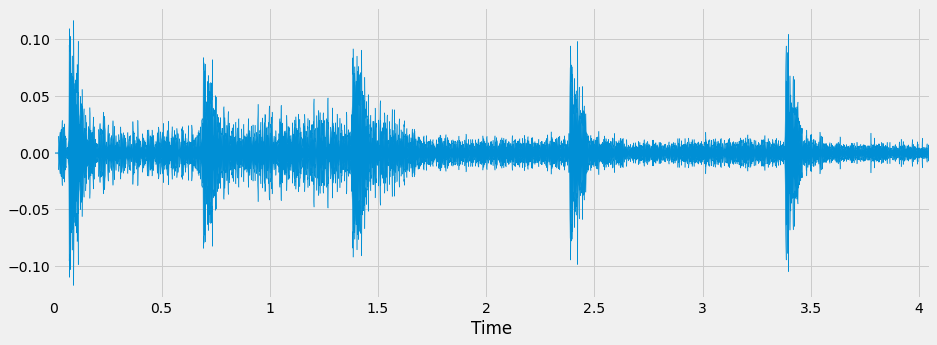

In [ ]:
### knock2
file_name = "/content/knock2.wav"
plt.figure(figsize=(14,5))
data,sample_rate=librosa.load(file_name)
librosa.display.waveplot(data,sr=sample_rate)
ipd.Audio(file_name)

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None) # make it 10s
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path =  "/content/knock2.wav"
result_predict = predict_one(file_path)

result_predict

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
112640.0
122880.0
133120.0
143360.0
153600.0
163840.0
174080.0
184320.0


array([[[[-2.73922176e+01, -5.52057031e+00],
         [-2.36768036e+01, -5.52057031e+00],
         [-4.24210930e+01, -5.52057031e+00],
         ...,
         [-6.62101746e+01, -4.44404528e-15],
         [-6.62101746e+01, -4.44404528e-15],
         [-6.62101746e+01, -4.44404528e-15]],

        [[-6.62101746e+01, -4.44404528e-15],
         [-6.62101746e+01, -4.44404528e-15],
         [-6.62101746e+01, -4.44404528e-15],
         ...,
         [-6.60704498e+01,  1.40702566e-02],
         [-6.62101746e+01,  1.40702566e-02],
         [-6.62101746e+01,  1.40702566e-02]],

        [[-6.62101746e+01, -4.44404528e-15],
         [-6.62101746e+01, -4.44404528e-15],
         [-6.62101746e+01, -4.44404528e-15],
         ...,
         [-3.42552209e+00,  8.58341364e+00],
         [ 4.18849087e+00,  8.58341364e+00],
         [-2.16502953e+01,  8.58341364e+00]],

        ...,

        [[-6.62101746e+01,  5.76216952e+00],
         [-6.62101746e+01,  5.76216952e+00],
         [-6.62101746e+01,  5.76216952

In [ ]:
predictions = model.predict(result_predict)
print(predictions)

[[2.89225882e-05 4.50720592e-07 3.47265595e-04 6.48924470e-05
  6.30323669e-08 1.16372087e-06 3.82318336e-04 2.28006169e-02
  5.07916127e-07 1.93021096e-05 2.02515075e-05 1.30873877e-06
  3.29223252e-03 2.75739530e-05 1.40044406e-07 3.28652931e-07
  4.64658369e-05 8.33625293e-08 1.35919781e-05 2.78835576e-02
  1.68097372e-07 1.01246602e-08 1.76823087e-04 2.89306035e-06
  3.06325524e-06 9.30215478e-01 8.04022989e-07 3.23228697e-08
  2.95937625e-05 1.85366353e-05 2.08777771e-03 1.18104031e-03
  1.52998800e-05 1.07784849e-03 6.95525378e-05 1.01805339e-03
  3.26500813e-05 8.89486216e-07 8.52450728e-04 1.84761539e-05
  1.50898597e-06 1.21910149e-10 2.90820990e-05 1.50534659e-04
  1.03852915e-06 4.08723135e-05 2.20420861e-05 6.91566165e-05
  7.87073001e-03 8.23519367e-05]
 [2.30039386e-05 2.00088698e-06 1.14188297e-04 3.59015371e-06
  1.12062530e-07 3.71706374e-05 2.36848246e-05 5.95383704e-01
  2.57212577e-07 4.22316261e-05 1.10141147e-04 3.07956657e-06
  1.36892414e-02 8.16823285e-06 2.444

In [ ]:
# class ทั้งหมดที่ predict ออกมา
classes = np.argmax(predictions, axis = 1)
print(classes)

[25  7 35 19 48 48 48 48 25 19 25  7  7 48  5  7]


In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[25, 7, 35, 19, 48, 5]


In [ ]:
# คำตอบสุดท้าย (class และ ชื่อ class)
for key, val in my_dict.items():
  for i in range(len(last_result)):
    if key == last_result[i]:
      print(key, ":" ,val)

5 : cat
7 : insects
19 : thunderstorm
25 : footsteps
35 : washing_machine
48 : fireworks


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

In [ ]:
target_name = np.array(df['category'])

In [ ]:
y_true = np.argmax(y_test,axis=1)

y_pred = np.argmax(model.predict(X_test),axis=1)

print(classification_report(y_true,y_pred,target_names=target_name))

                  precision    recall  f1-score   support

             dog       0.65      0.70      0.67       104
         rooster       0.52      0.39      0.44       108
             pig       0.94      0.48      0.64       100
             cow       0.47      0.62      0.54       118
            frog       0.85      0.85      0.85       110
             cat       0.34      0.55      0.42       107
             hen       0.67      0.52      0.58        99
         insects       0.60      0.75      0.67       106
           sheep       0.70      0.70      0.70       108
            crow       0.80      0.76      0.78       106
            rain       0.88      0.93      0.91       105
       sea_waves       0.73      0.87      0.79       100
  crackling_fire       0.90      0.67      0.77       105
        crickets       0.81      0.93      0.86        99
  chirping_birds       0.88      0.51      0.65       113
     water_drops       0.49      0.33      0.39       109
            w



---



#**Predict By Vote**

In [ ]:
from collections import Counter

## Hard Vote

In [ ]:
def predict_one(file_name, bands = 60, frames = 41):
    window_size = 512 * (frames - 1)
    log_specgrams = []
    labels = []

    sound_clip,s = librosa.load(file_name) # 5sec
    #sound_clip   = np.concatenate((sound_clip,sound_clip),axis=None)
    #label = file_name.split("/")[-1].split("-")[-1].split(".")[0]
    for (start,end) in windows(sound_clip,window_size):
          if(len(sound_clip[start:end]) == window_size):
              signal = sound_clip[start:end]
              melspec = librosa.feature.melspectrogram(signal, n_mels = bands)
              logspec = librosa.core.amplitude_to_db(melspec)
              logspec = logspec.T.flatten()[:, np.newaxis].T
              log_specgrams.append(logspec)
              #labels.append(label)

    log_specgrams = np.asarray(log_specgrams).reshape(len(log_specgrams),bands,frames,1)
    features = np.concatenate((log_specgrams, np.zeros(np.shape(log_specgrams))), axis = 3)
    for i in range(len(features)):
        features[i, :, :, 1] = librosa.feature.delta(features[i, :, :, 0])

    return np.array(features)

In [ ]:
file_path = "/content/baby.wav"
result_predict = predict_one(file_path)
predictions = model.predict(result_predict)
classes = np.argmax(predictions, axis = 1)
print(classes)

10240.0
20480.0
30720.0
40960.0
51200.0
61440.0
71680.0
81920.0
92160.0
102400.0
1/1 [==============================] - 0s 72ms/step
[ 7 10  4 10 10 10  7  0]


In [ ]:
occurence_count = Counter(classes)
maxx_class = occurence_count.most_common(1)[0][0]
print(maxx_class)

10


In [ ]:
# true = [40,40 ,40, 40, 40, 40 ,40, 40, 40 ,40, 40 ,40 ,40, 40, 40, 40]
# print(classification_report(true,classes))

In [ ]:
# ตัด class ที่ซ้ำกันออก
last_result = []

for i in range(len(classes)):
    if classes[i] not in last_result:
        last_result.append(classes[i])

print(last_result)

[7, 10, 4, 0]


In [ ]:
ans = classes.tolist()
ans

[7, 10, 4, 10, 10, 10, 7, 0]

In [ ]:
max_classes = []
max_cc = []
for i in range(len(last_result)): # วนในที่ตัด class ที่ซ้ำกันออก
  max_count = ans.count(last_result[i]) #
  if max_count >= 3:
    max_classes.append(last_result[i])
    max_cc.append(max_count)
    print(max_classes, max_cc)

[10] [4]


In [ ]:
for key, val in my_dict.items():
  for i in range(len(max_classes)):
    if key == max_classes[i]:
      print(key, ":" ,val)

10 : เสียงแตรรถ


## Soft Vote

In [ ]:
import statistics

In [ ]:
predictions

array([[3.05388699e-06, 2.84621024e-06, 1.60483103e-02, 1.83701530e-04,
        1.74662296e-06, 1.76361464e-05, 8.78048711e-04, 1.08921074e-03,
        2.06521887e-04, 5.77182174e-01, 6.72987971e-06, 6.12614490e-02,
        9.09055586e-07, 2.10092962e-03, 3.26369237e-03, 7.93811637e-07,
        4.87317266e-06, 5.83441249e-07, 2.08673440e-03, 2.21283000e-04,
        1.43453747e-07, 1.51705240e-06, 1.05781191e-05, 1.62773521e-03,
        2.14993561e-05, 4.74139483e-07, 5.15448892e-06, 1.90092633e-05,
        3.07166033e-06, 1.10023884e-05, 1.15069952e-07, 4.98536683e-05,
        4.81616212e-07, 3.15583966e-05, 1.72599946e-04, 5.20695903e-06,
        1.64139532e-02, 3.33241542e-06, 2.25101232e-07, 1.74990134e-07,
        3.57760200e-06, 1.05567651e-05, 1.22510153e-03, 1.10136978e-02,
        2.82658160e-01, 7.09935603e-06, 2.07653894e-08, 2.18068399e-02,
        3.33547272e-04, 2.49178015e-06],
       [1.01474507e-05, 5.01209001e-07, 5.77110127e-02, 8.09826543e-06,
        2.25882005e-07,

In [ ]:
m = []
for i in range(len(classes)):
  predictions_mean = predictions[i]
  m = statistics.mean(predictions_mean)*100
  print(classes[i], m)

9 1.9999999552965164
11 2.0000001415610313
35 1.9999999552965164
35 1.9999999552965164
45 1.9999999552965164
40 2.0000001415610313
45 1.9999999552965164
10 1.9999997690320015
10 2.0000001415610313
10 2.0000001415610313
45 1.9999999552965164
10 2.0000001415610313
10 1.9999999552965164
45 2.0000003278255463
43 1.9999999552965164
27 2.0000001415610313


2.0000001415610313

In [ ]:
avg_value = sum(predictions)/len(classes)
avg_value

array([1.31783781e-05, 6.57679777e-07, 5.84900985e-03, 3.10763658e-04,
       2.13925568e-06, 4.79733535e-05, 3.76312621e-03, 3.69471940e-03,
       1.49730304e-05, 3.63506228e-02, 3.43381763e-01, 3.59303057e-02,
       1.55304121e-02, 6.29546400e-03, 1.12432977e-02, 1.42426165e-06,
       8.46242358e-04, 1.31467314e-04, 2.34627689e-04, 1.30874654e-02,
       1.02167774e-04, 3.06002079e-07, 1.95771034e-04, 9.14573320e-04,
       7.50276149e-06, 6.64496292e-06, 4.31069435e-04, 6.62846863e-02,
       1.29682167e-05, 1.30583023e-04, 1.13167880e-04, 1.20959427e-04,
       4.82508622e-05, 3.01372726e-04, 1.48963789e-03, 7.11777136e-02,
       1.64415466e-03, 3.30264584e-06, 3.43443971e-04, 2.45571459e-06,
       3.41623165e-02, 7.77877460e-04, 3.89004080e-03, 5.50756790e-02,
       4.94986326e-02, 2.09786192e-01, 1.77204420e-05, 2.45995577e-02,
       2.13035033e-03, 1.30466890e-06], dtype=float32)

In [ ]:
predictions_mean = predictions[0]
print(statistics.mean(predictions_mean))

0.02


In [ ]:
predictions_mean*100

array([1.0638859e-06, 5.0582987e-08, 6.4040134e-05, 1.2986903e-03,
       6.3257858e-08, 3.8020094e-06, 2.2963733e-05, 5.5433649e-01,
       7.8336876e-07, 1.4087399e-06, 1.3939229e-01, 1.9279696e-03,
       1.0629154e-04, 1.1844353e-06, 5.2164552e-05, 3.9930644e-08,
       9.2961936e-06, 1.1574057e-05, 3.6020486e-03, 3.4614836e-03,
       2.0087736e-08, 3.3565765e-08, 2.5737987e-05, 7.2249740e-09,
       3.9152415e-08, 1.4397527e-05, 5.3203957e-09, 9.8470924e+01,
       2.1171791e-09, 1.7204709e-08, 1.0213328e-07, 6.5924390e-03,
       1.0319784e-05, 4.6207593e-04, 1.2500851e-06, 1.3104579e-04,
       2.3373202e-06, 3.6833121e-06, 1.3589468e-09, 2.6489199e-06,
       8.8458946e-05, 2.7403644e-07, 2.6731504e-02, 7.1776503e-01,
       6.6417523e-02, 5.0927312e-03, 1.1355635e-06, 1.4397143e-03,
       6.6462093e-07, 3.5872847e-06], dtype=float32)

In [ ]:
import os

In [ ]:
os.listdir('/content/sound/ESC-50-master/audio/')

['3-71964-A-4.wav',
 '4-186693-A-17.wav',
 '2-95567-A-23.wav',
 '2-76408-A-22.wav',
 '4-147657-A-46.wav',
 '5-160614-H-48.wav',
 '5-188655-A-10.wav',
 '3-151212-A-24.wav',
 '5-103418-A-2.wav',
 '3-132852-A-10.wav',
 '5-219379-C-11.wav',
 '1-16746-A-15.wav',
 '4-164243-A-26.wav',
 '3-164216-C-6.wav',
 '4-181707-A-32.wav',
 '1-46353-A-49.wav',
 '1-27166-A-35.wav',
 '5-182404-A-18.wav',
 '1-77241-A-3.wav',
 '1-31836-A-4.wav',
 '5-177957-A-40.wav',
 '2-37870-A-2.wav',
 '2-72547-C-14.wav',
 '3-152912-A-26.wav',
 '1-23996-A-35.wav',
 '3-164630-A-11.wav',
 '1-50455-A-44.wav',
 '3-158056-A-31.wav',
 '2-77346-A-46.wav',
 '5-215179-A-13.wav',
 '1-24524-B-19.wav',
 '5-181977-A-35.wav',
 '2-118072-A-0.wav',
 '3-169907-A-29.wav',
 '4-169127-B-41.wav',
 '1-39937-A-28.wav',
 '4-211502-A-30.wav',
 '1-45641-A-27.wav',
 '5-195517-A-7.wav',
 '1-60676-A-34.wav',
 '3-118658-B-41.wav',
 '2-102435-A-37.wav',
 '4-197454-B-28.wav',
 '2-102414-G-17.wav',
 '1-69165-A-34.wav',
 '2-108767-B-9.wav',
 '2-209474-A-25

In [ ]:
import os, fnmatch
def find(pattern, path):
    result = []
    for root, dirs, files in os.walk(path):
        for name in files:
            if fnmatch.fnmatch(name, pattern):
                result.append(os.path.join(root, name))
    return result

find('*32.wav', '/content/ESC_new')

['/content/ESC_new/1-62594-A-32.wav']